In [1]:
cd TileEM/

/Users/dorislee/Desktop/Research/seg/crowd-seg/analysis/TileEM


In [2]:
%pylab inline
from dataset import Dataset
from BB2tile import *
from greedy import *
from data import *
from experiment import *
import pandas as pd 
import pickle as pkl

Populating the interactive namespace from numpy and matplotlib


In [8]:
cd output/

[Errno 2] No such file or directory: 'output/'
/Users/dorislee/Desktop/Research/seg/crowd-seg/analysis/TileEM/output


In [15]:
object_lst = list(object_tbl.id)

In [74]:
likelihood = np.loadtxt("likelihood.txt",delimiter=',') #La,Lm,Ll,Le
La = likelihood[:,0]
Lm = likelihood[:,1]
Ll = likelihood[:,2]
Le = likelihood[:,3]
Tarea = np.loadtxt("Tarea.txt",delimiter=',') #Ta,Tm,Tl,Te
Ta = Tarea[:,0]
Tm = Tarea[:,1]
Tl = Tarea[:,2]
Te = Tarea[:,3]

In [75]:
def interpolate_gaps(values, limit=None):
    """
    Fill gaps using linear interpolation, optionally only fill gaps up to a
    size of `limit`.
    """
    values = np.asarray(values)
    i = np.arange(values.size)
    valid = np.isfinite(values)
    filled = np.interp(i, i[valid], values[valid])

    if limit is not None:
        invalid = ~valid
        for n in range(1, limit+1):
            invalid[:-n] &= invalid[n:]
        filled[invalid] = np.nan

    return filled

In [373]:
true_area=[]
for objid in object_lst:
    my_BBG  = pd.read_csv("../../my_ground_truth.csv")
    ground_truth_match = my_BBG[my_BBG.object_id==objid]
    x_locs,y_locs =  process_raw_locs([ground_truth_match["x_locs"].iloc[0],ground_truth_match["y_locs"].iloc[0]])
    true_area.append(shapely.geometry.Polygon(zip(x_locs,y_locs)).area)
true_area=np.array(true_area)

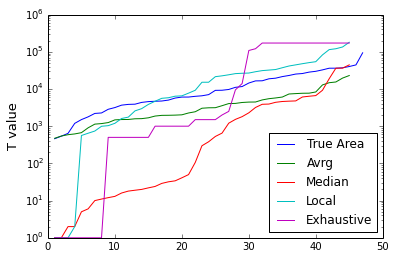

In [375]:
plt.semilogy(object_lst,true_area[np.argsort(true_area)],label="True Area")
plt.semilogy(object_lst[:len(Ta)],interpolate_gaps(Ta[np.argsort(Ta)]),label='Avrg')
plt.semilogy(object_lst[:len(Ta)],interpolate_gaps(Tm[np.argsort(Tm)]),label='Median')
plt.semilogy(object_lst[:len(Ta)],interpolate_gaps(Tl[np.argsort(Tl)]),label='Local')
plt.semilogy(object_lst[:len(Ta)],interpolate_gaps(Te[np.argsort(Te)]),label='Exhaustive')
plt.ylabel("T value",fontsize=13)
plt.legend(loc="left right")

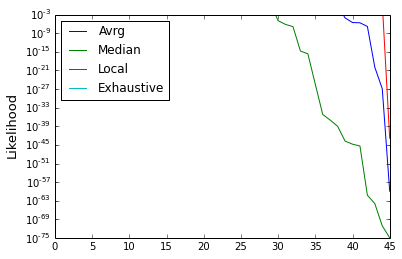

In [82]:
plt.semilogy(object_lst[:len(Ta)],interpolate_gaps(La[np.argsort(La)][::-1]),label='Avrg')
plt.semilogy(object_lst[:len(Ta)],interpolate_gaps(Lm[np.argsort(Lm)][::-1]),label='Median')
plt.semilogy(object_lst[:len(Ta)],interpolate_gaps(Ll[np.argsort(Ll)][::-1]),label='Local')
plt.semilogy(object_lst[:len(Ta)],interpolate_gaps(Le[np.argsort(Le)][::-1]),label='Exhaustive')
plt.ylabel("Likelihood",fontsize=13)
plt.legend(loc="left right")

In [101]:
from matplotlib.colors import LogNorm
def plot_tile_gamma(objid,solutionList,tiles,gammas):
    # Create a masked image for the object
    # where each of the worker BB is considered a mask and overlaid on top of each other 
    img_name = img_info[img_info.id==int(object_tbl[object_tbl.id==objid]["image_id"])]["filename"].iloc[0]
    fname = "../../../web-app/app/static/"+img_name+".png"
    
    width,height = get_size(fname)
    mega_mask = np.zeros((height,width))
    img_mask = Image.new('L', (width, height), 0)
    for tile_idx in range(len(tiles)):
        xlocs,ylocs = zip(*tiles[tile_idx])
        ImageDraw.Draw(img_mask).polygon(zip(ylocs,xlocs), outline=gammas[tile_idx], fill=gammas[tile_idx])
#         plt.figure()
#         plt.imshow(img_mask, cmap='PuBu_r', norm=LogNorm(vmin=1e-6, vmax=1))
#         plt.colorbar()
        #mask = np.array(img_mask)==1
        mega_mask+=np.array(img_mask)

    # Visualize mega_mask
    plt.figure()
    plt.imshow(mega_mask+1e-8, cmap='PuBu_r', norm=LogNorm(vmin=0.1, vmax=1))
#         img =mpimg.imread(fname)
#         plt.imshow(img,alpha=0.4)
    plt.colorbar()
    return mega_mask

In [352]:
import shapely
from matplotlib.collections import PatchCollection
from matplotlib.patches import Polygon
def plot_tile_gamma(objid,solnset,tiles,gamma,PLOT_BBG=False,PLOT_MLSOLN=False):

    area_lst=[]

    for tile in tiles:
        area_lst.append(shapely.geometry.Polygon(tile).area)
    sorted_ascend_tile_by_size= list(np.array(tiles)[np.argsort(area_lst)])
    fig,ax = plt.subplots(1)
    if PLOT_MLSOLN:
        # Cascade Union creates a Polygon or MultiPolygon Object
        ML_regions = join_tiles(solnset,tiles)
        if type(ML_regions)==shapely.geometry.polygon.Polygon:
            y,x=ML_regions.exterior.xy
            plt.plot(x, y, '-', color='lime',linewidth=1)    
        else:
            for region in ML_regions:
                y,x=region.exterior.xy
                plt.plot(x, y, '-', color='lime',linewidth=1)    
    if PLOT_BBG:
        BBG_lst=[]
        my_BBG  = pd.read_csv("../../my_ground_truth.csv")
        ground_truth_match = my_BBG[my_BBG.object_id==objid]
        x_locs,y_locs =  process_raw_locs([ground_truth_match["x_locs"].iloc[0],ground_truth_match["y_locs"].iloc[0]])
        plt.plot(x_locs,y_locs,'--',color='#0000ff',linewidth=1.5)

    # Gamma Tiles 
    patches = []
    for tile_idx in range(len(tiles)):
        tile =  sorted_ascend_tile_by_size[tile_idx]
        polygon = Polygon(zip(tile[:,1],tile[:,0]),closed=True,\
                          linewidth=1,edgecolor='black',fill=False)
        patches.append(polygon)

    collection = PatchCollection(patches,cmap=matplotlib.cm.autumn_r,alpha=0.25)
    pcollection = ax.add_collection(collection)
    
    collection.set_array(gamma)
    ax.add_collection(collection)
    plt.colorbar(collection)
    img_name = img_info[img_info.id==int(object_tbl[object_tbl.id==objid]["image_id"])]["filename"].iloc[0]
    fname = "../../../web-app/app/static/"+img_name+".png"
    plt.title("Object {0} [{1}]".format(objid,object_tbl[object_tbl.object_id==objid]["name"].iloc[0]))
    img =mpimg.imread(fname)
    width,height = get_size(fname)
    plt.xlim(0,width)
    plt.ylim(height,0)
    plt.imshow(img,alpha=0.8)
    ax.autoscale_view()

plotting solution list as red

In [353]:
from shapely.ops import cascaded_union
def join_tiles(solutionList,tiles): 
    return cascaded_union([shapely.geometry.Polygon(tiles[int(tidx)-1]) for tidx in solutionList])

In [354]:
def plot_all_obj_tiles(experiment_idx):
    '''
    0 = Avrg 
    1 = Median
    2 = Local Search
    3 = Exhaustive Search
    '''
    for objid in object_lst:
        try:
            tiles = pkl.load(open("tiles{}.pkl".format(objid),'r'))
            solnset = pkl.load(open("solnfile{}.pkl".format(objid),'r'))#solutionLista,solutionListm,solutionListl,solutionListe
            gammas = pkl.load(open("gfile{}.pkl".format(objid),'r'))#ga,gm,gl,ge
            mask = plot_tile_gamma(objid,solnset[idx],tiles,gammas[idx],PLOT_BBG=True,PLOT_MLSOLN=True)
        except(IOError):
            pass

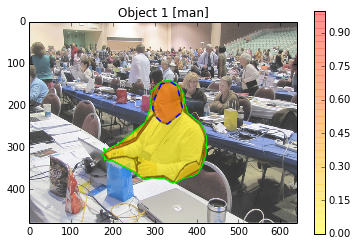

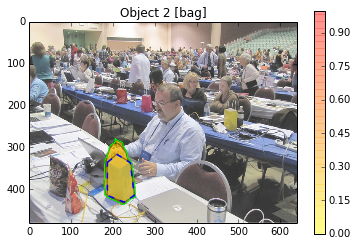

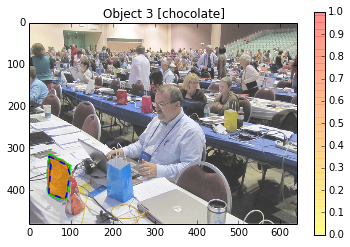

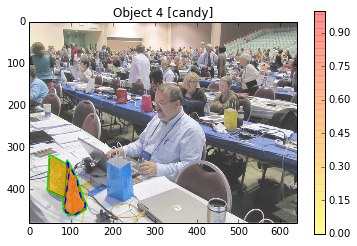

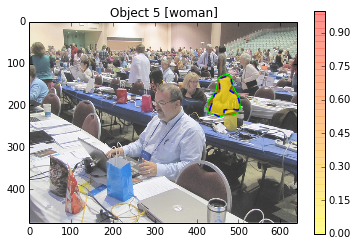

...

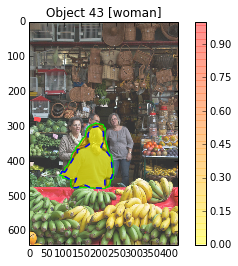

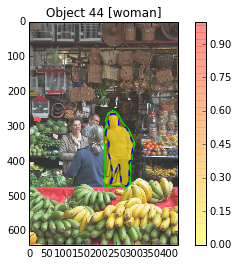

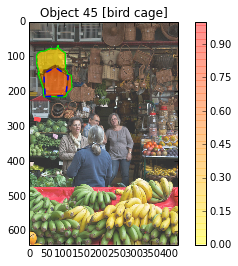

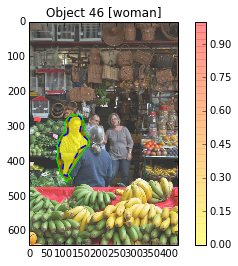

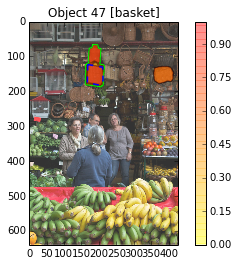

In [355]:
plot_all_obj_tiles(0)

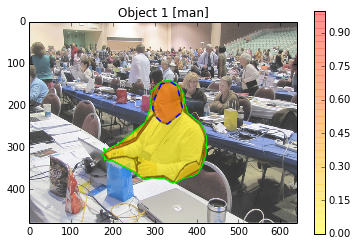

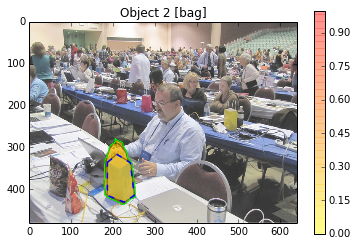

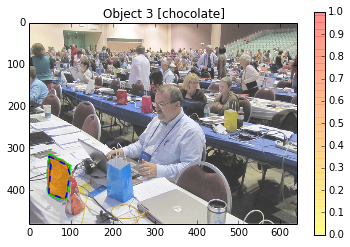

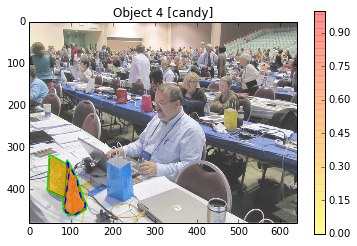

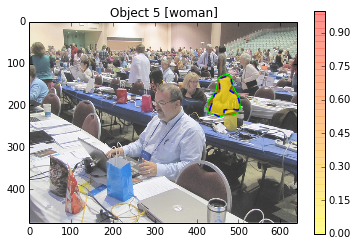

...

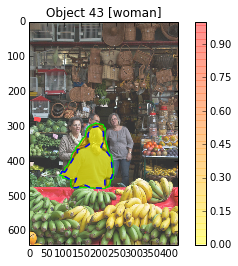

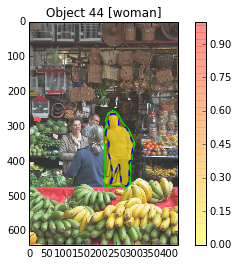

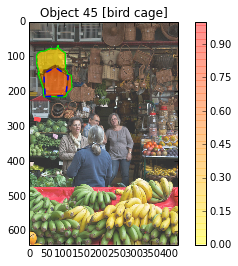

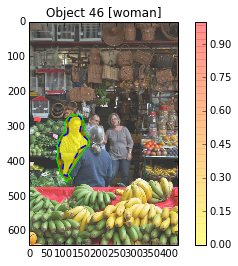

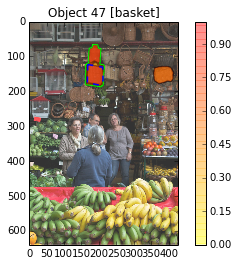

In [356]:
plot_all_obj_tiles(1)

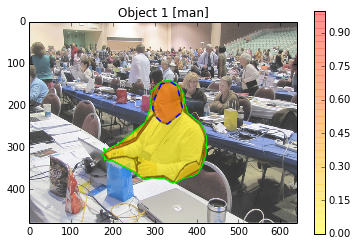

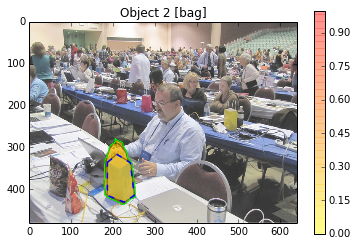

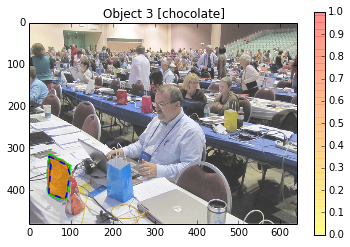

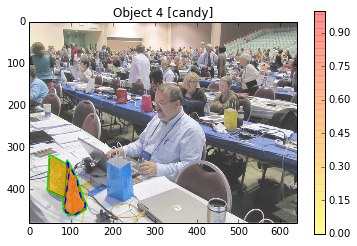

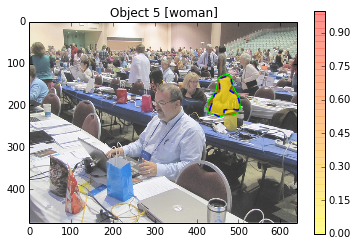

...

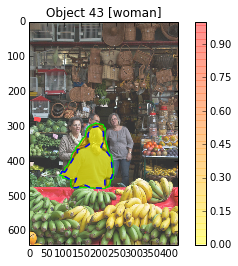

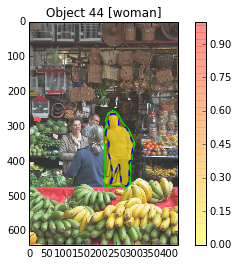

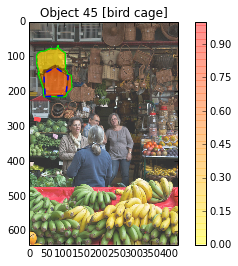

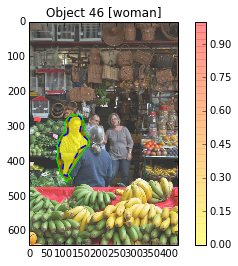

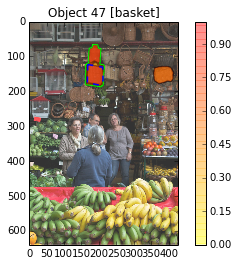

In [357]:
plot_all_obj_tiles(2)

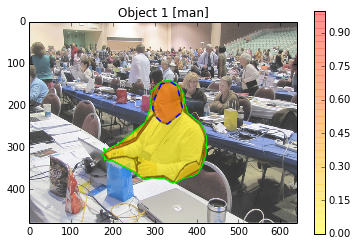

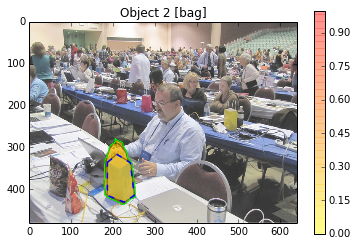

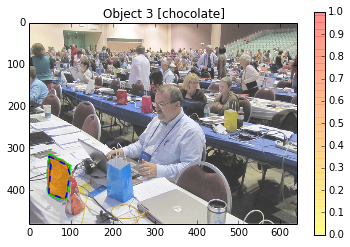

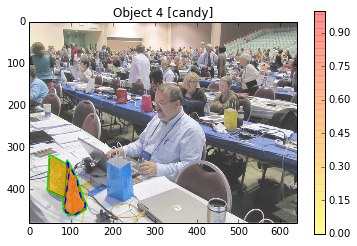

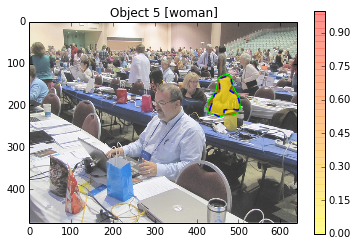

...

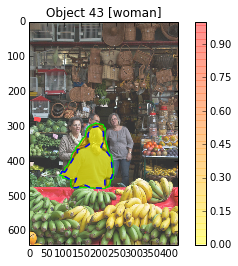

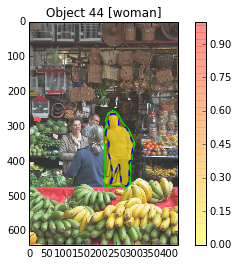

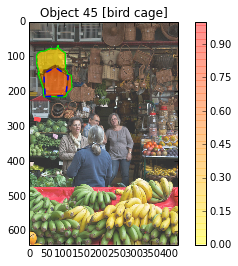

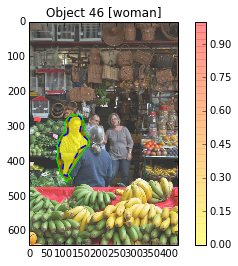

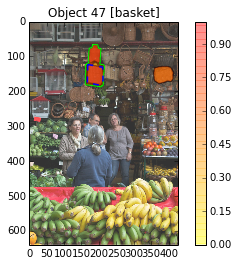

In [358]:
plot_all_obj_tiles(3)